# Plot beam shapes from the spline models
- Includes: I, xx-yy, xx, yy

In [1]:
from astropy.io import fits
import pandas as pd
from astropy import modeling
import numpy as np
import matplotlib as mpl
from matplotlib import gridspec
import matplotlib.pyplot as plt
#import seaborn as sns
from scipy.stats import norm
#from skimage.measure import profile_line
from scipy.interpolate import RectBivariateSpline

mpl.rcParams['font.family'] = 'serif'
%matplotlib inline

In [6]:
# old set
freq_label = []
CRVAL3_new = 1280e6+(12.207e3*(-(24576/2-14000)))  #rewrite to this
CDELT3_new = 12.207e3*1050
for i in range(0,10):
    freq_label.append(CRVAL3_new+(i*CDELT3_new))
    
freq_label_gh = np.round(np.array(freq_label)/1e9,2)

# new freq range
# freq_label = []
# CRVAL3_new = 1370e6+(12.207e3*(-(24576/2-6500)))  #rewrite to this
# CDELT3_new = 12.207e3*1000
# for i in range(0,18):
#     freq_label.append(CRVAL3_new+(i*CDELT3_new))
    
# freq_label_gh = np.round(np.array(freq_label)/1e9,2)

In [14]:
def make_beam_plots(date, chan):
    nrows = 7
    ncols = 7*2+1
    beams = 40
    freq = 1234867750.0 + 18310500.0 * chan  #old files
    #freq = 1299345884.0 + 12207000.0 * chan
    
    # location on happili-05
    #df_1 = pd.read_csv('/tank/apertif/driftscans/spline/{0}/beam_models_{0}_chann_{1}_pol_I.csv'.format(date, chan))
    #location on my mac
    df_1 = pd.read_csv('/Users/denes/Research/APERTIF/Primary_beam/spline_models/{0}/beam_models_{0}_chann_{1}_pol_I.csv'.format(date, chan))

    
    size = int(np.sqrt(len(df_1['B{:02d}_{}'.format(1, int(freq))])))

    fig = plt.figure(figsize=(14,12))
    gs = gridspec.GridSpec(nrows=nrows, ncols=ncols, figure=fig) #, width_ratios=[1]*ncols, height_ratios=[1]*nrows, wspace=0.4, hspace=0.7)

    # Arrange the plots approx according to beam spacing (only beam 0 really fails)
    ax = [None] * beams
    for b in range(beams-1,-1,-1):
        if (b <= 39) & (b >= 33):
            ax[b] = fig.add_subplot(gs[0,2*(39-b):2*(39-b)+2])
        if (b <= 32) & (b >= 27):
            ax[b] = fig.add_subplot(gs[1,2*(32-b)+1:2*(32-b)+2+1])
        if (b <= 26) & (b >= 21):
            ax[b] = fig.add_subplot(gs[2,2*(26-b)+2:2*(26-b)+2+2])
        if (b == 0):
            ax[b] = fig.add_subplot(gs[3,2*3:2*3+2])
        if (b <= 20) & (b >= 15):
            ax[b] = fig.add_subplot(gs[4,2*(20-b)+1:2*(20-b)+2+1])
        if (b <= 14) & (b >= 8):
            ax[b] = fig.add_subplot(gs[5,2*(14-b):2*(14-b)+2])
        if (b <= 7) & (b >= 1):
            ax[b] = fig.add_subplot(gs[6,2*(7-b)+1:2*(7-b)+2+1])
        ax[b].set_xticks([])
        ax[b].set_yticks([])

    for b in range(beams):
        cb = np.array(df_1['B{:02d}_{}'.format(b, int(freq))]).reshape(size, size)
        cb = np.flipud(cb)
        ax[b].imshow(cb)
        ax[b].contour(cb, levels=[0,0.2,0.4,0.6,0.8], colors='w')
        ax[b].contour(cb, levels=[0.1, 0.5], colors='r', linestyle=':')
        #ax[b].contour(cb, levels=[0.5], colors='r', linestyle=':')
        ax[b].set_title("Beam {}".format(b), size=10)

    fig.suptitle("Beam models {} chan {} {} GHz".format(date, chan, freq_label_gh[chan]), size=18)    
    # tank
    #plt.savefig('/tank/apertif/driftscans/spline/{0}/{0}_beams_chan_{1}.png'.format(date, chan), dpi=100, bbox_inches="tight")
    # mac
    plt.savefig('/Users/denes/Research/APERTIF/Primary_beam/spline_models/{0}/{0}_beams_chan_{1}.png'.format(date, chan), dpi=100, bbox_inches="tight")



<ipython-input-14-a1f9ec3af5c9>:44: UserWarning: The following kwargs were not used by contour: 'linestyle'
  ax[b].contour(cb, levels=[0.1, 0.5], colors='r', linestyle=':')


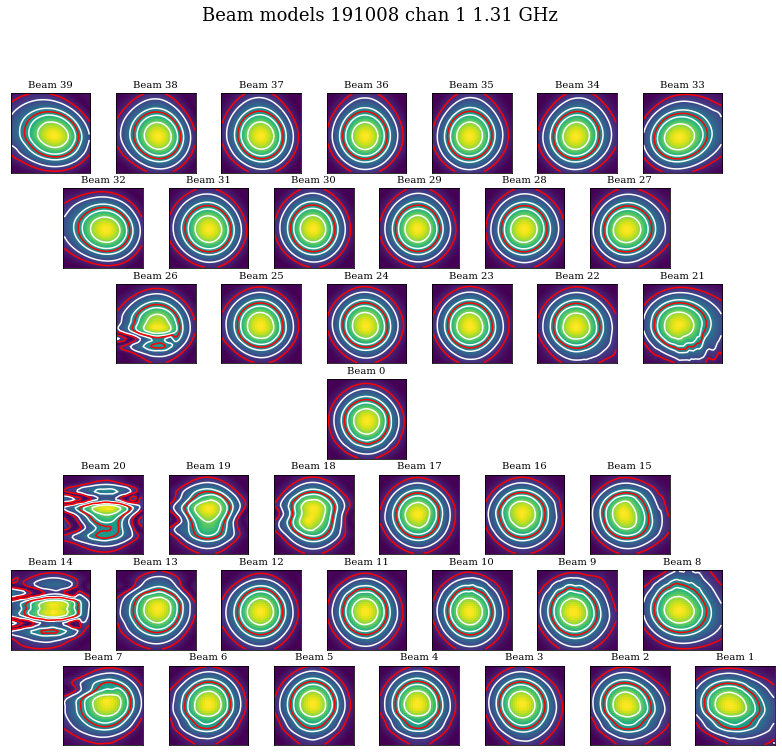

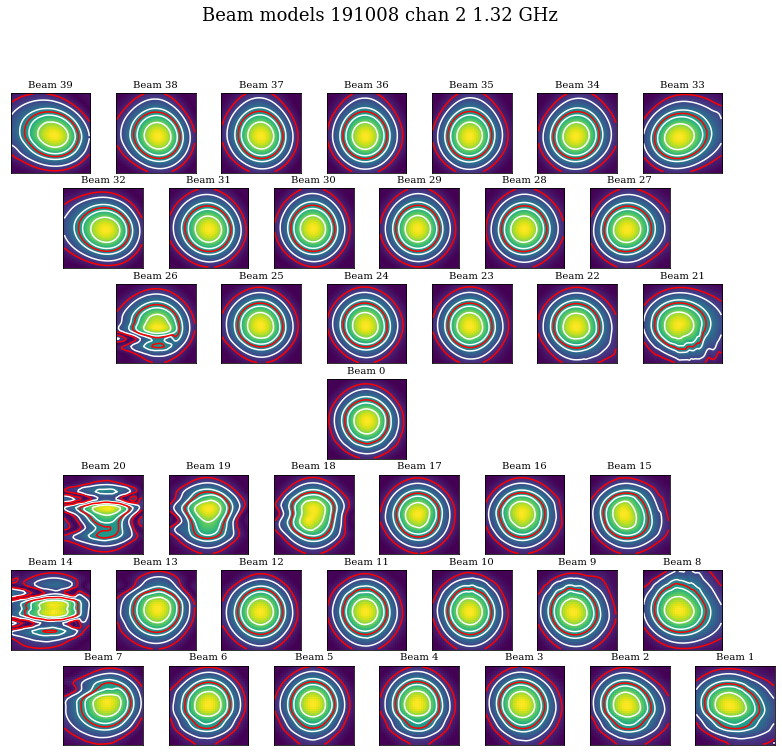

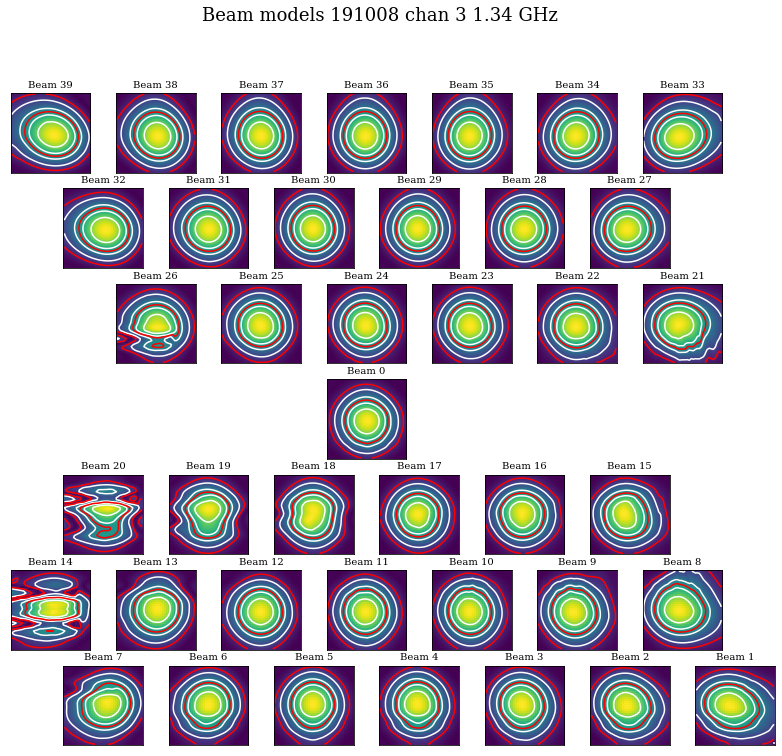

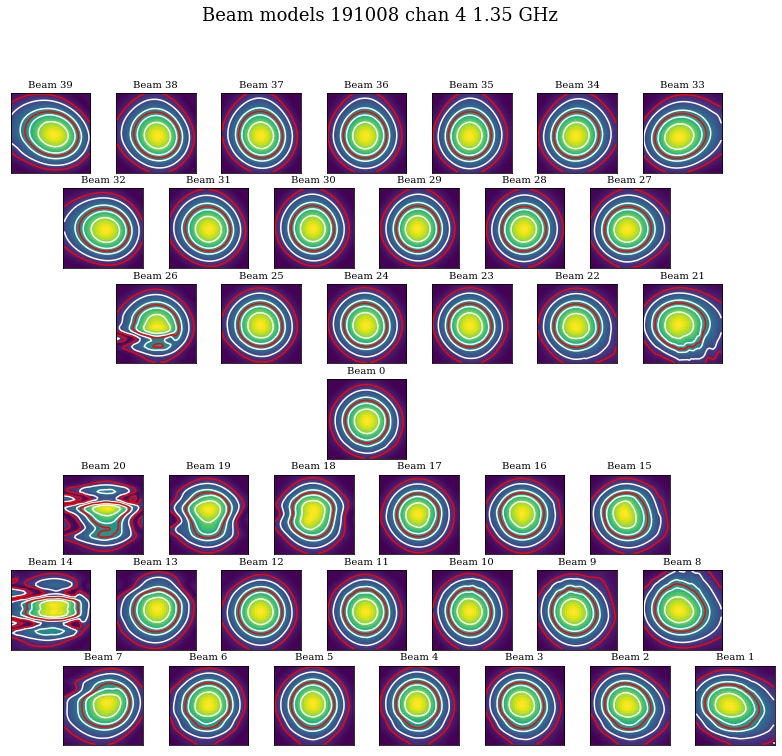

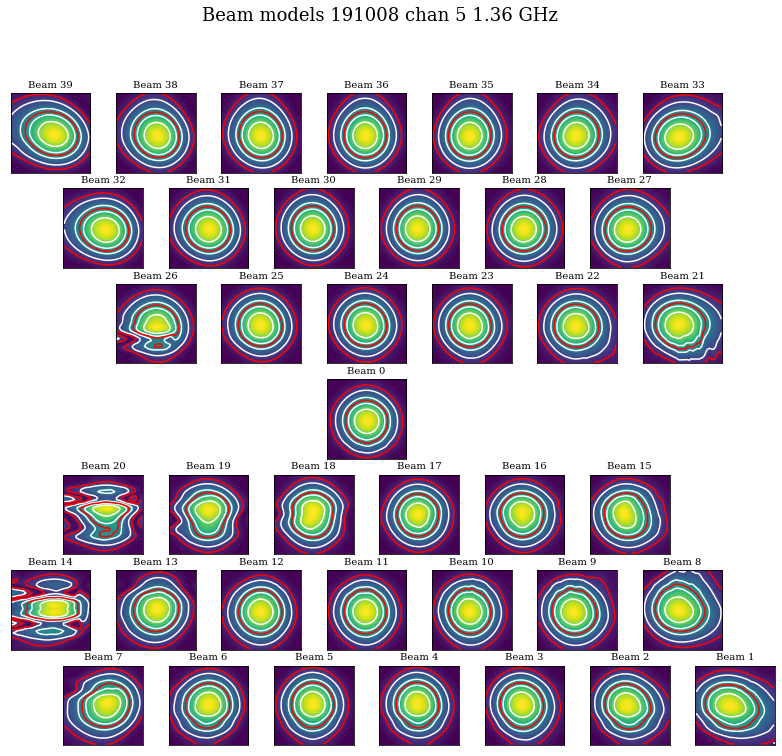

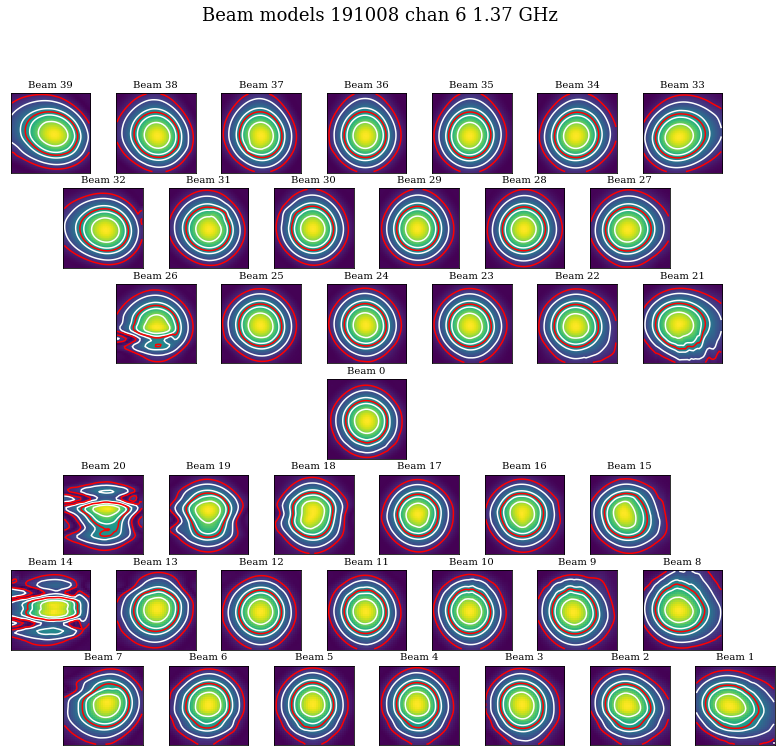

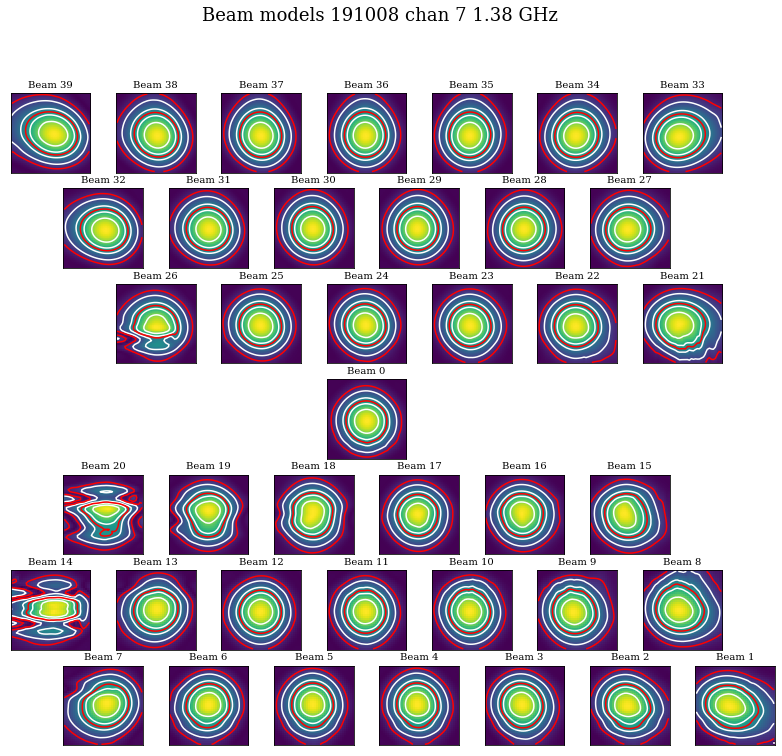

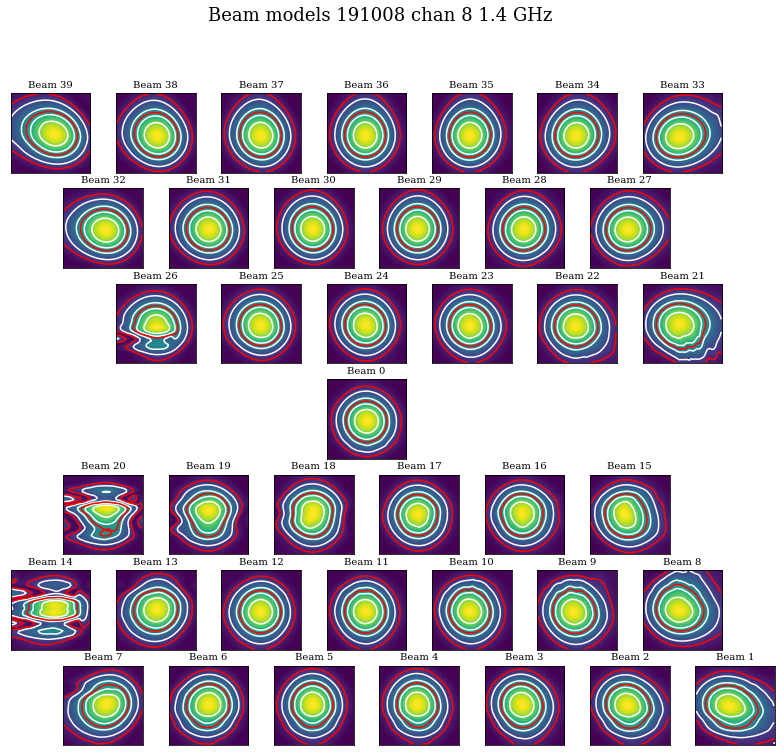

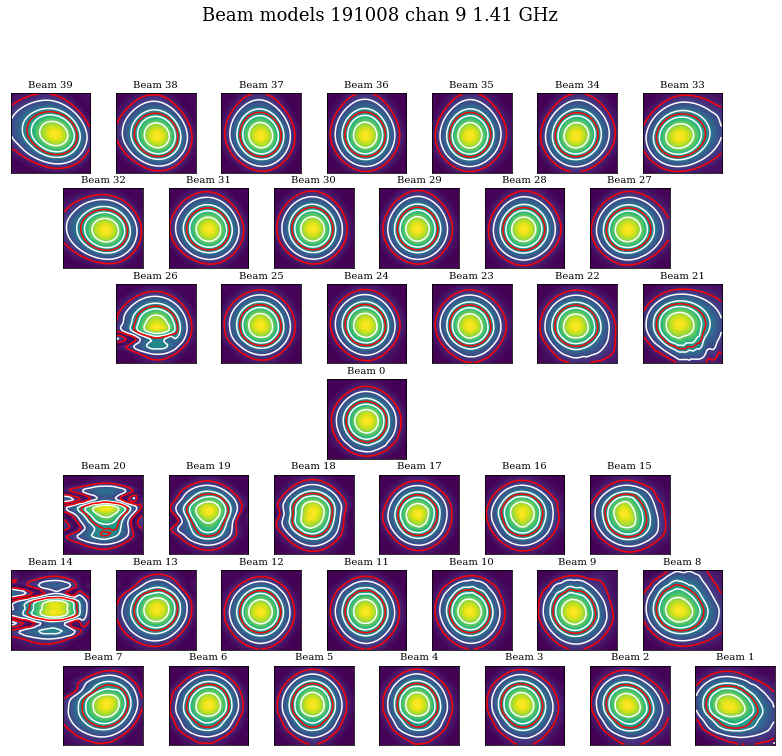

In [19]:
for i in range(1,10):
    make_beam_plots('191008', i)

In [9]:
def make_beam_plots_v2(date, chan):
    nrows = 7
    ncols = 7*2+1
    beams = 40
    #freq = 1234867750.0 + 18310500.0 * chan  # old files 
    freq = 1299345884.0 + 12207000.0 * chan

    #tank
    #df_1 = pd.read_csv('/tank/apertif/driftscans/spline/{0}/beam_models_{0}_chann_{1}_pol_xx.csv'.format(date, chan))
    #df_2 = pd.read_csv('/tank/apertif/driftscans/spline/{0}/beam_models_{0}_chann_{1}_pol_yy.csv'.format(date, chan))
    
    # mac
    df_1 = pd.read_csv('/Users/denes/Research/APERTIF/Primary_beam/spline_models/{0}/beam_models_{0}_chann_{1}_pol_xx.csv'.format(date, chan))
    df_2 = pd.read_csv('/Users/denes/Research/APERTIF/Primary_beam/spline_models/{0}/beam_models_{0}_chann_{1}_pol_yy.csv'.format(date, chan))
    
    size = int(np.sqrt(len(df_1['B{:02d}_{}'.format(1, int(freq))])))

    fig = plt.figure(figsize=(14,12))
    gs = gridspec.GridSpec(nrows=nrows, ncols=ncols, figure=fig) #, width_ratios=[1]*ncols, height_ratios=[1]*nrows, wspace=0.4, hspace=0.7)

    # Arrange the plots approx according to beam spacing (only beam 0 really fails)
    ax = [None] * beams
    for b in range(beams-1,-1,-1):
        if (b <= 39) & (b >= 33):
            ax[b] = fig.add_subplot(gs[0,2*(39-b):2*(39-b)+2])
        if (b <= 32) & (b >= 27):
            ax[b] = fig.add_subplot(gs[1,2*(32-b)+1:2*(32-b)+2+1])
        if (b <= 26) & (b >= 21):
            ax[b] = fig.add_subplot(gs[2,2*(26-b)+2:2*(26-b)+2+2])
        if (b == 0):
            ax[b] = fig.add_subplot(gs[3,2*3:2*3+2])
        if (b <= 20) & (b >= 15):
            ax[b] = fig.add_subplot(gs[4,2*(20-b)+1:2*(20-b)+2+1])
        if (b <= 14) & (b >= 8):
            ax[b] = fig.add_subplot(gs[5,2*(14-b):2*(14-b)+2])
        if (b <= 7) & (b >= 1):
            ax[b] = fig.add_subplot(gs[6,2*(7-b)+1:2*(7-b)+2+1])
        ax[b].set_xticks([])
        ax[b].set_yticks([])

    for b in range(beams):
        cb_1 = np.array(df_1['B{:02d}_{}'.format(b, int(freq))]).reshape(size, size)
        cb_2 = np.array(df_2['B{:02d}_{}'.format(b, int(freq))]).reshape(size, size)
        ax[b].imshow(cb_1-cb_2)
        ax[b].contour(cb_1-cb_2, levels=np.arange(-0.1,0.1,0.02), colors='w')
        ax[b].set_title("Beam {}".format(b), size=10)

    fig.suptitle("Beam models xx-yy {} chan {} {} GHz".format(date, chan, round(freq/1e9,2)), size=18)    
    # tank
    #plt.savefig('/tank/apertif/driftscans/spline/{0}/{0}_beams_xx-yy_chan_{1}.png'.format(date, chan), dpi=100, bbox_inches="tight")

    #mac
    plt.savefig('/Users/denes/Research/APERTIF/Primary_beam/spline_models/{0}/{0}_beams_xx-yy_chan_{1}.png'.format(date, chan), dpi=100, bbox_inches="tight")


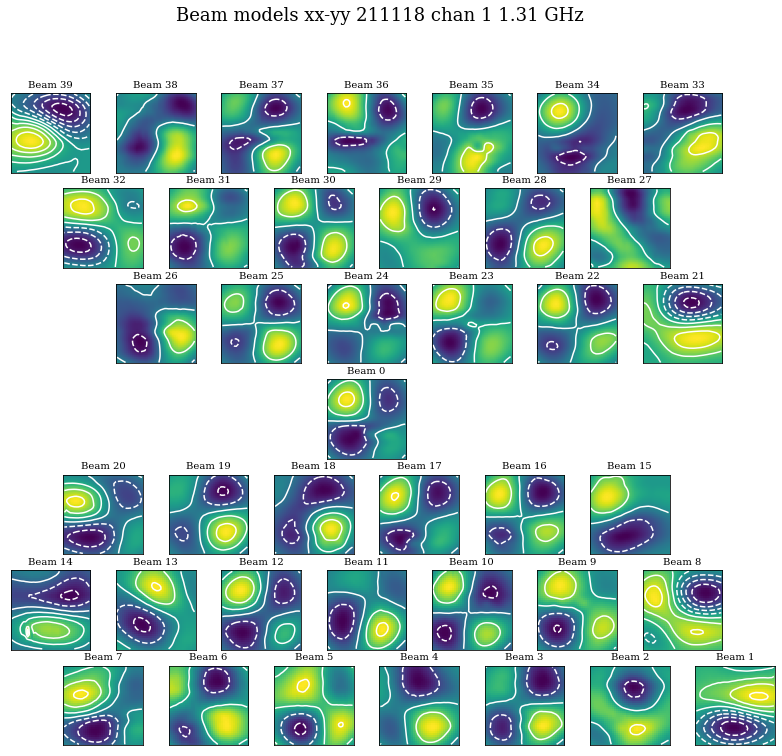

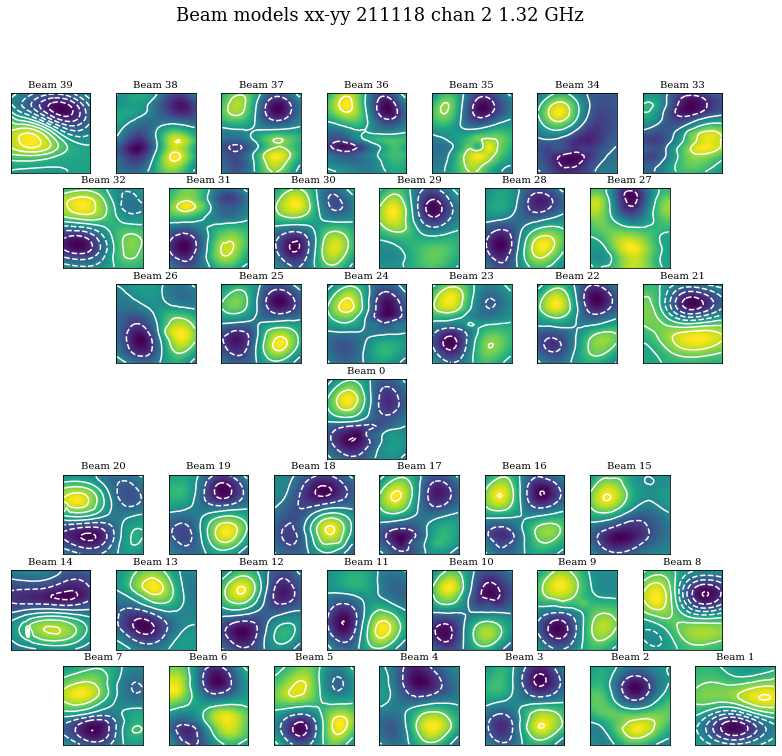

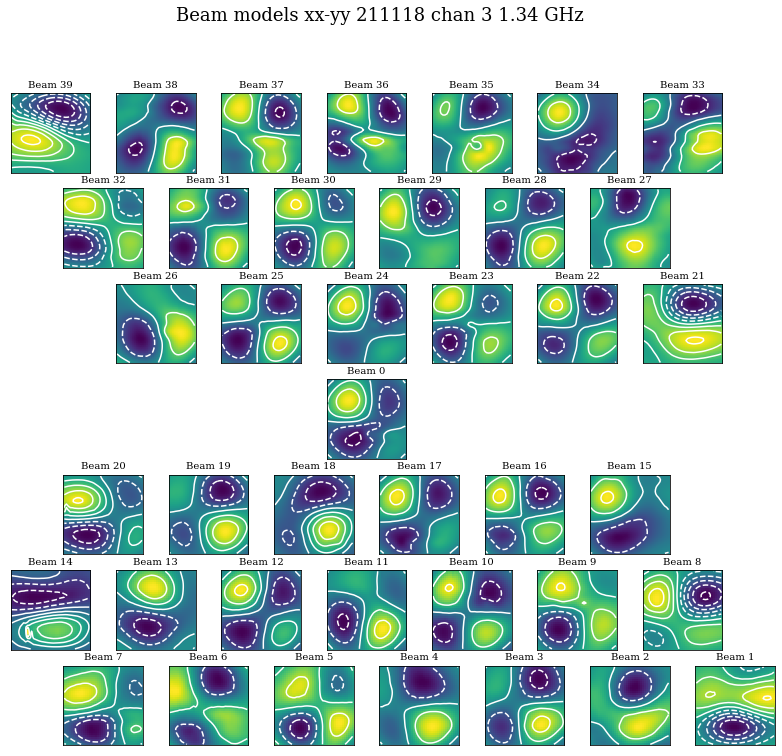

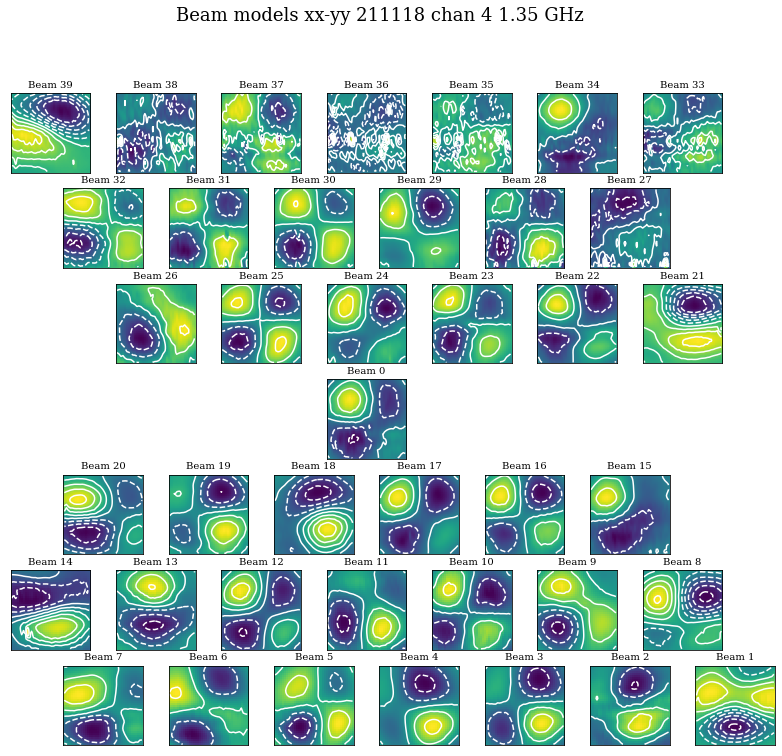

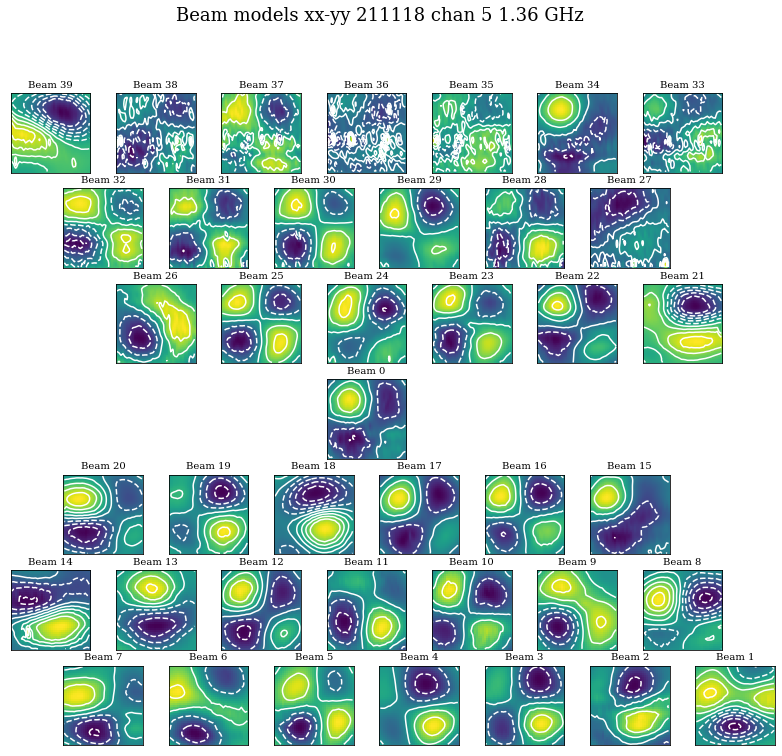

...

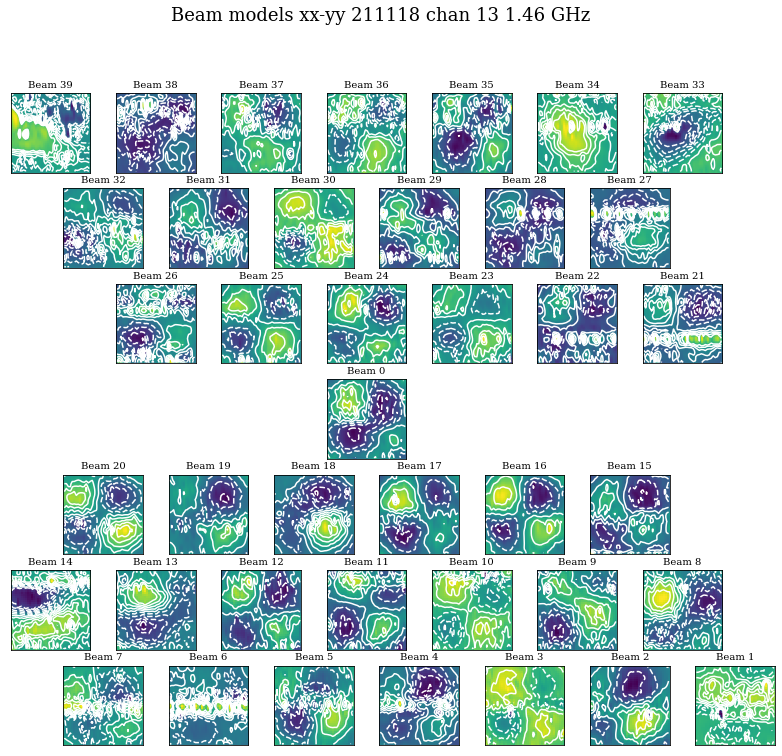

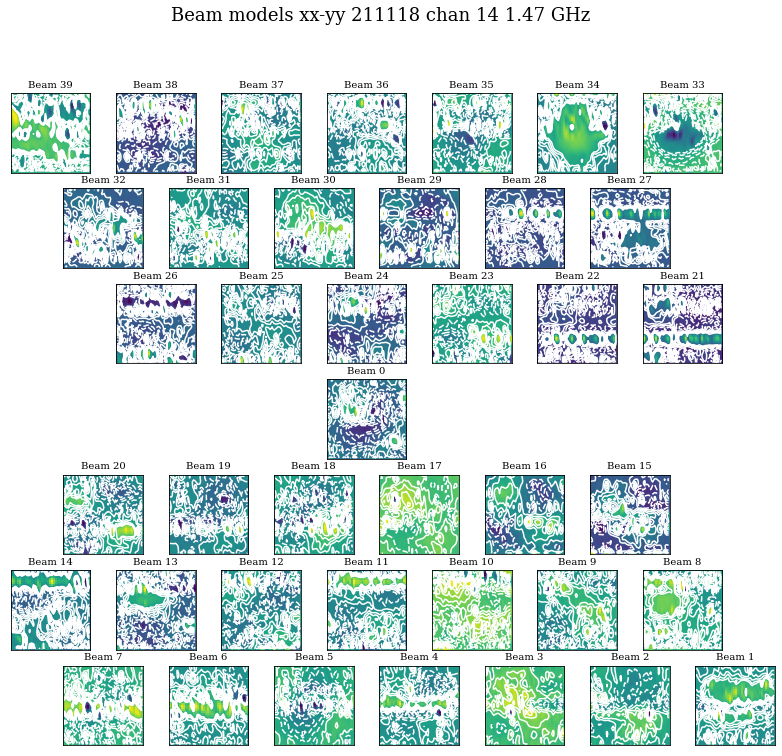

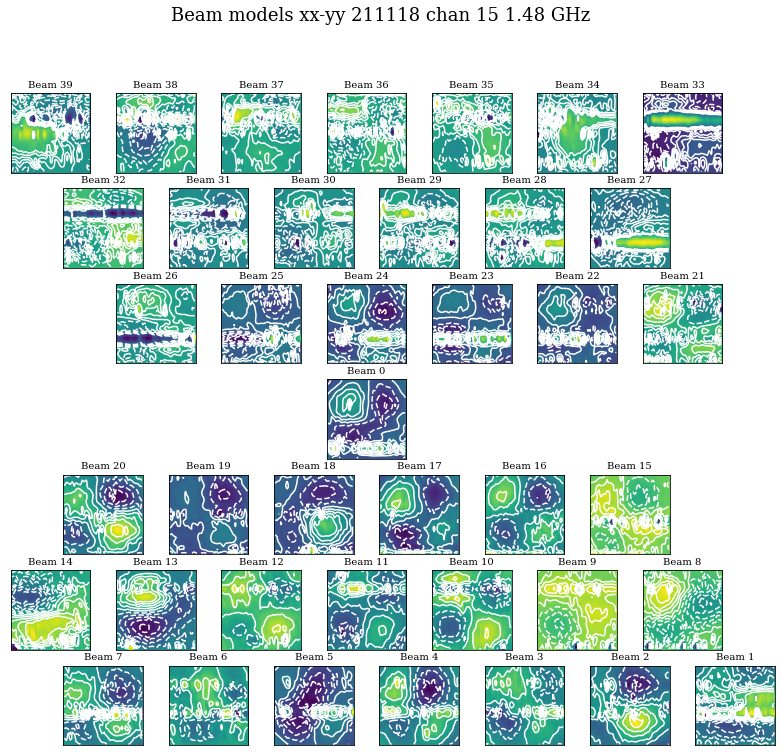

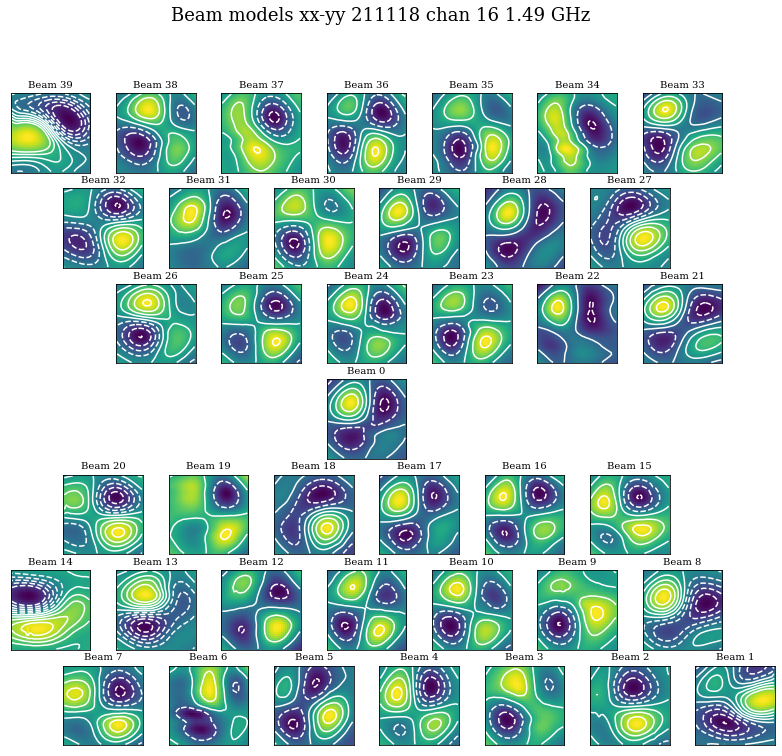

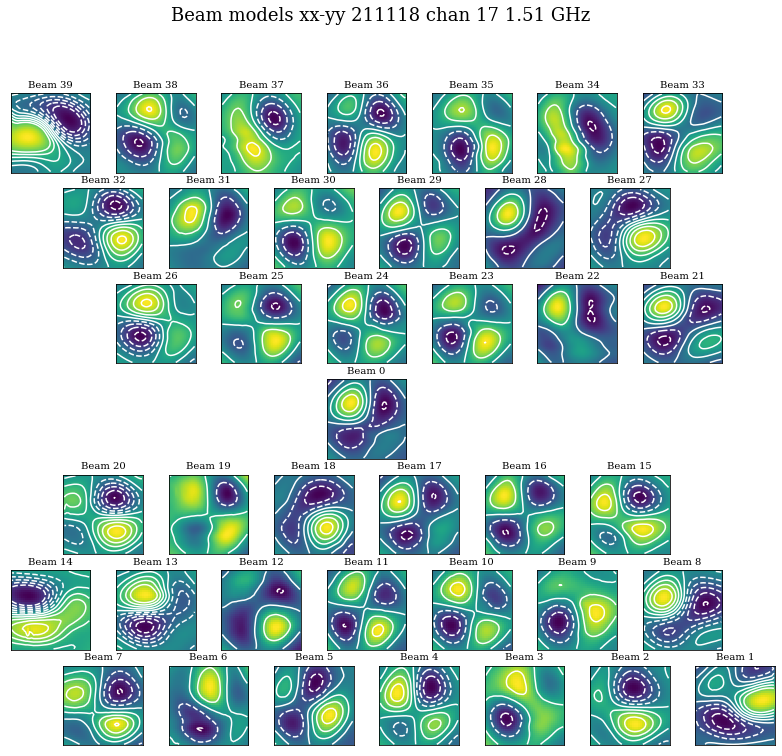

In [13]:
for i in range(1,18):
    make_beam_plots_v2('211118', i)

In [6]:
def make_beam_plots_xx(date, chan):
    nrows = 7
    ncols = 7*2+1
    beams = 40
    #freq = 1234867750.0 + 18310500.0 * chan #old files
    freq = 1299345884.0 + 12207000.0 * chan

    df_1 = pd.read_csv('/tank/apertif/driftscans/spline/{0}/beam_models_{0}_chann_{1}_pol_xx.csv'.format(date, chan))    
    size = int(np.sqrt(len(df_1['B{:02d}_{}'.format(1, int(freq))])))

    fig = plt.figure(figsize=(14,12))
    gs = gridspec.GridSpec(nrows=nrows, ncols=ncols, figure=fig) #, width_ratios=[1]*ncols, height_ratios=[1]*nrows, wspace=0.4, hspace=0.7)

    # Arrange the plots approx according to beam spacing (only beam 0 really fails)
    ax = [None] * beams
    for b in range(beams-1,-1,-1):
        if (b <= 39) & (b >= 33):
            ax[b] = fig.add_subplot(gs[0,2*(39-b):2*(39-b)+2])
        if (b <= 32) & (b >= 27):
            ax[b] = fig.add_subplot(gs[1,2*(32-b)+1:2*(32-b)+2+1])
        if (b <= 26) & (b >= 21):
            ax[b] = fig.add_subplot(gs[2,2*(26-b)+2:2*(26-b)+2+2])
        if (b == 0):
            ax[b] = fig.add_subplot(gs[3,2*3:2*3+2])
        if (b <= 20) & (b >= 15):
            ax[b] = fig.add_subplot(gs[4,2*(20-b)+1:2*(20-b)+2+1])
        if (b <= 14) & (b >= 8):
            ax[b] = fig.add_subplot(gs[5,2*(14-b):2*(14-b)+2])
        if (b <= 7) & (b >= 1):
            ax[b] = fig.add_subplot(gs[6,2*(7-b)+1:2*(7-b)+2+1])
        ax[b].set_xticks([])
        ax[b].set_yticks([])

    for b in range(beams):
        cb_1 = np.array(df_1['B{:02d}_{}'.format(b, int(freq))]).reshape(size, size)
        ax[b].imshow(cb_1, cmap='Oranges_r')
        ax[b].contour(cb_1, levels=[0,0.2,0.4,0.6,0.8], colors='w')
        ax[b].set_title("Beam {}".format(b), size=10)

    fig.suptitle("Beam models xx {} chan {} {} GHz".format(date, chan, round(freq/1e9,2)), size=18)    
    plt.savefig('/tank/apertif/driftscans/spline/{0}/{0}_beams_xx_chan_{1}.png'.format(date, chan), dpi=100, bbox_inches="tight")


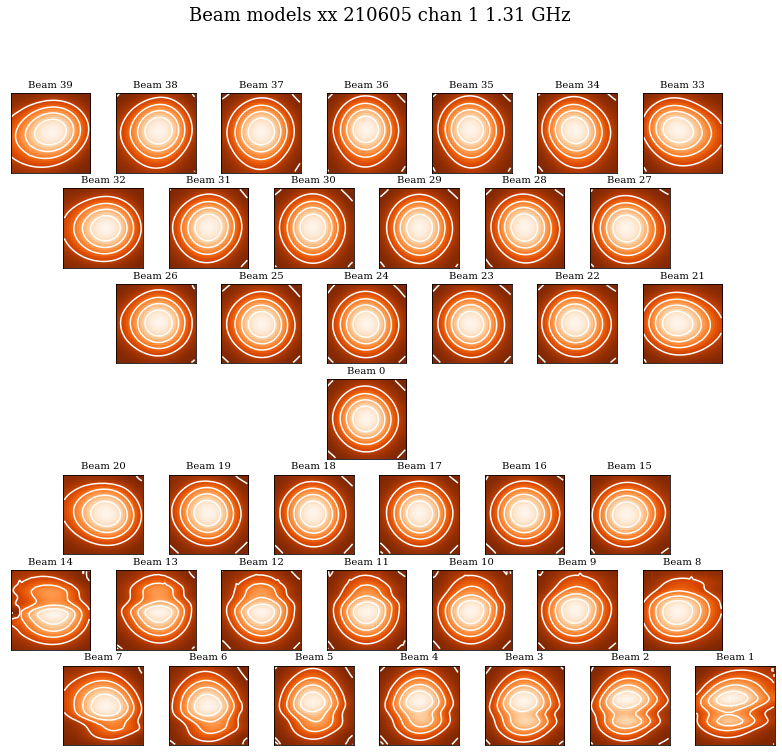

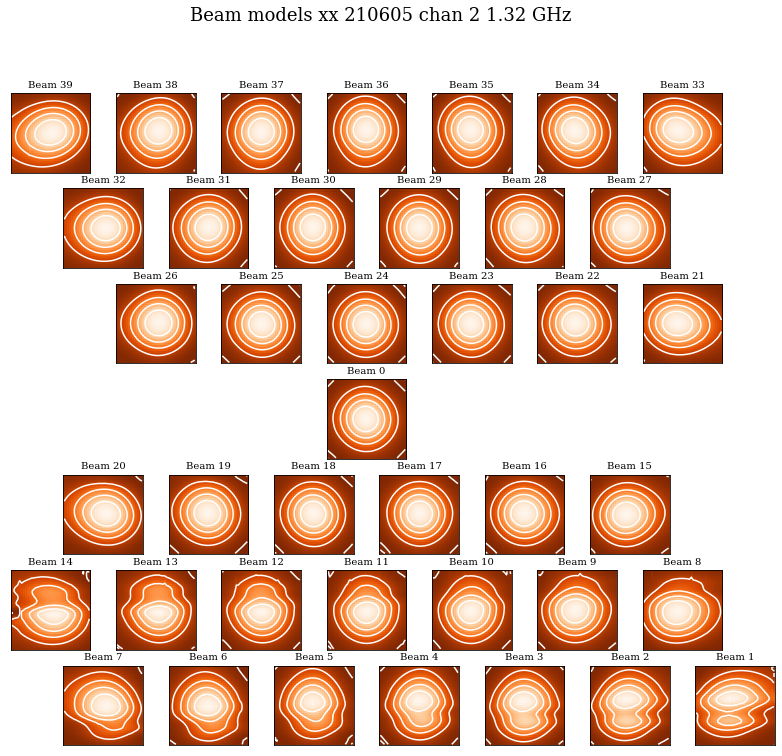

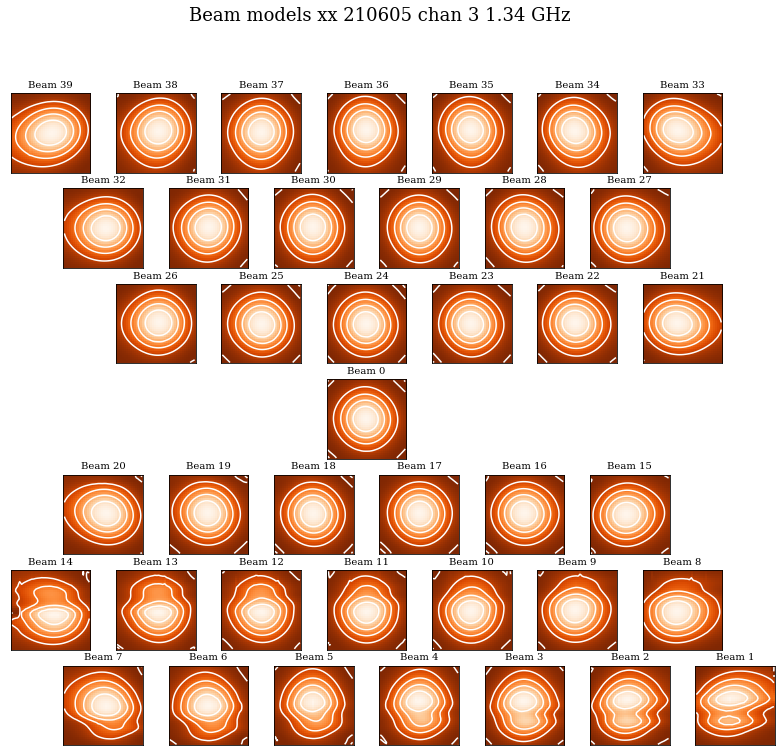

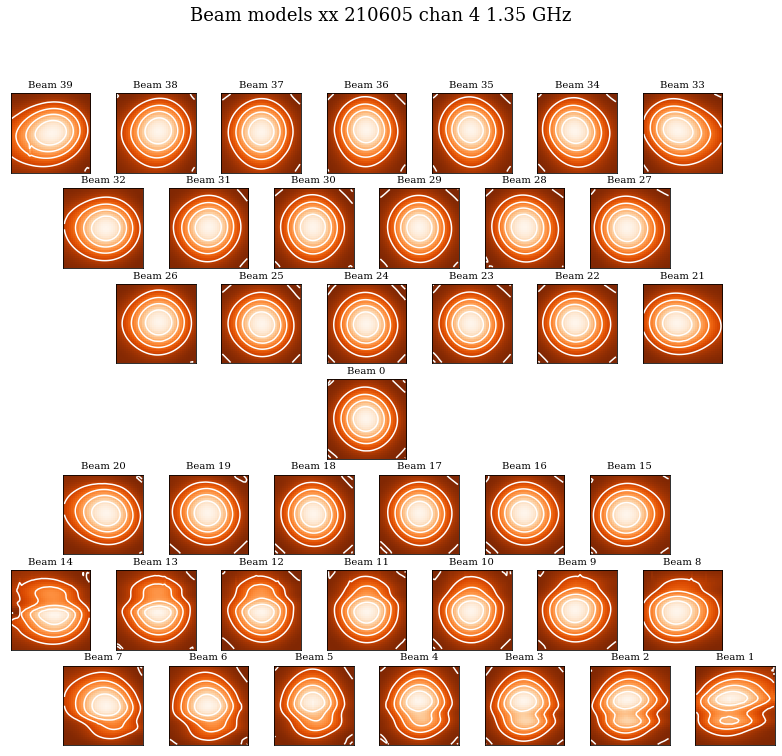

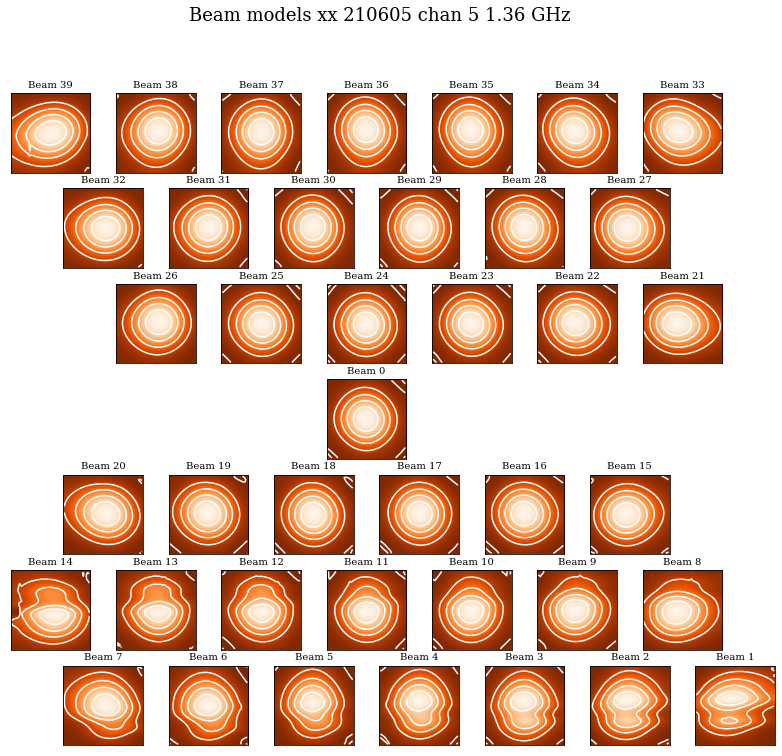

...

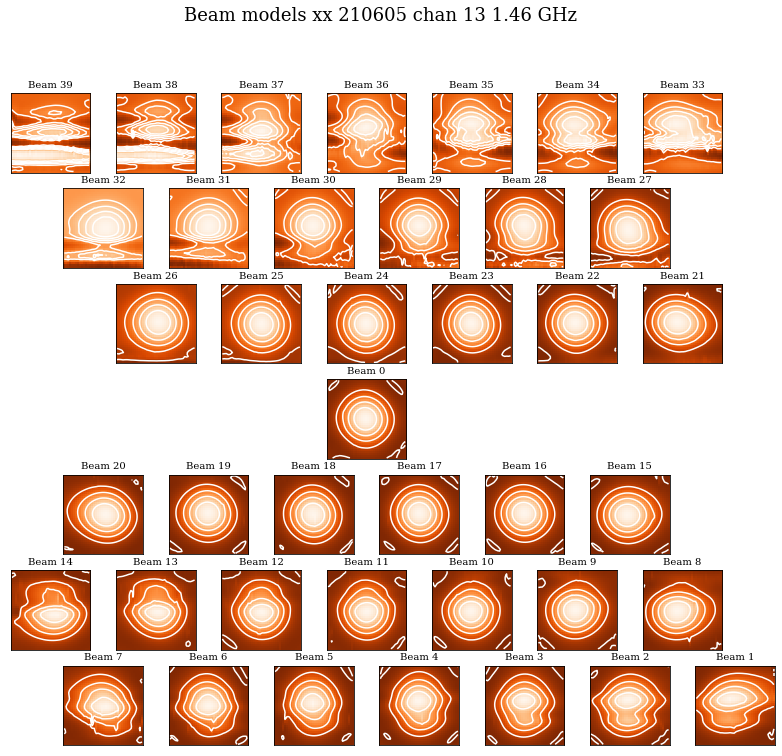

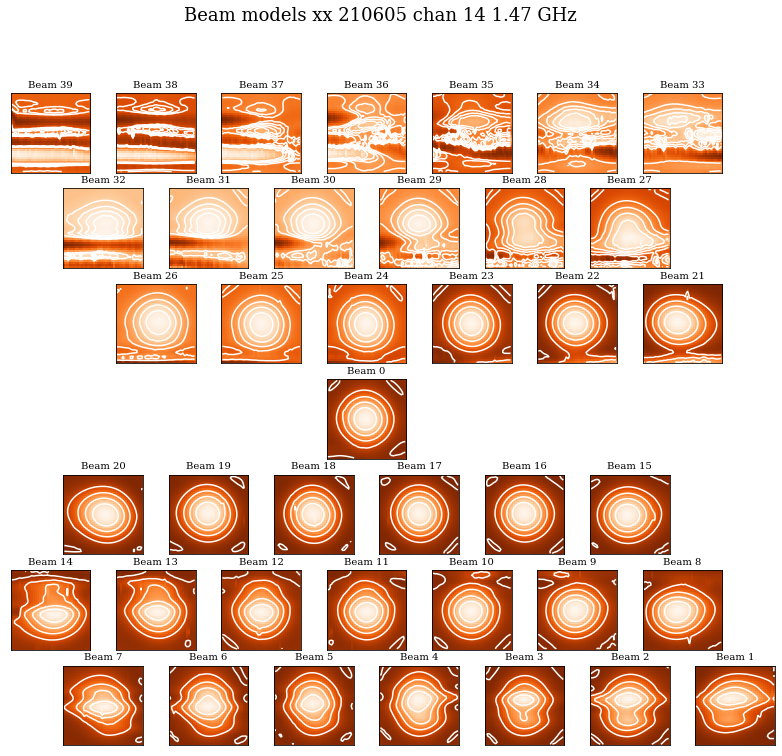

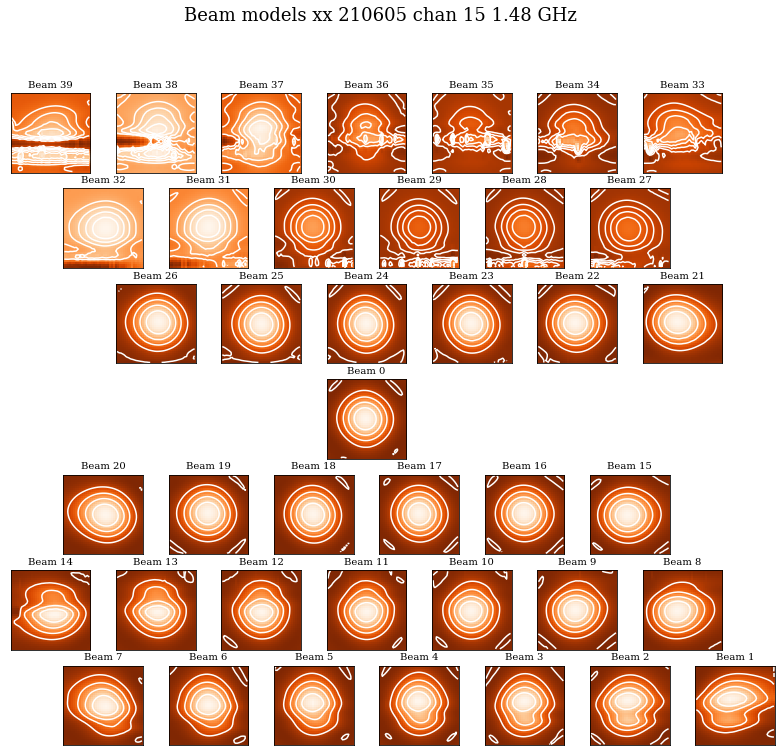

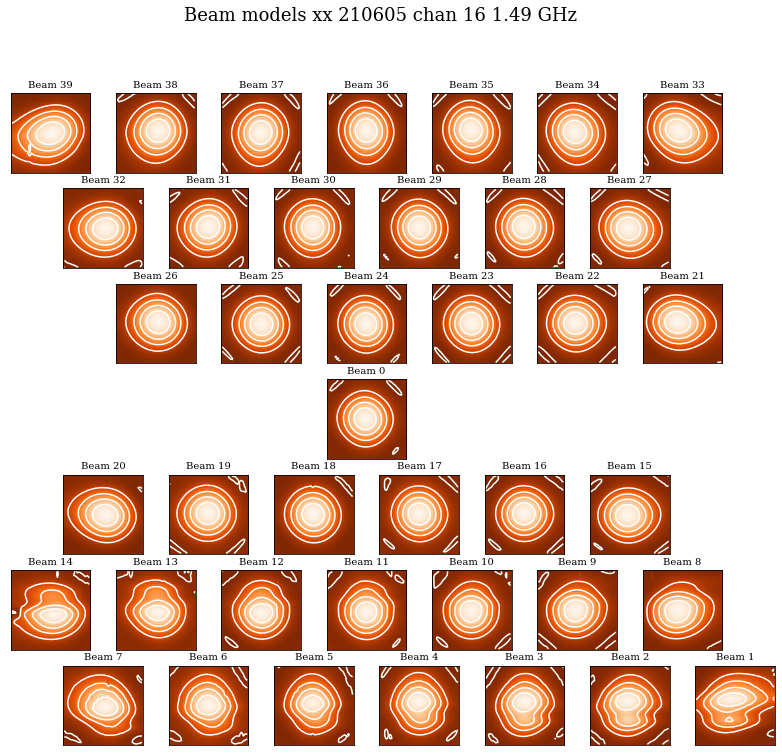

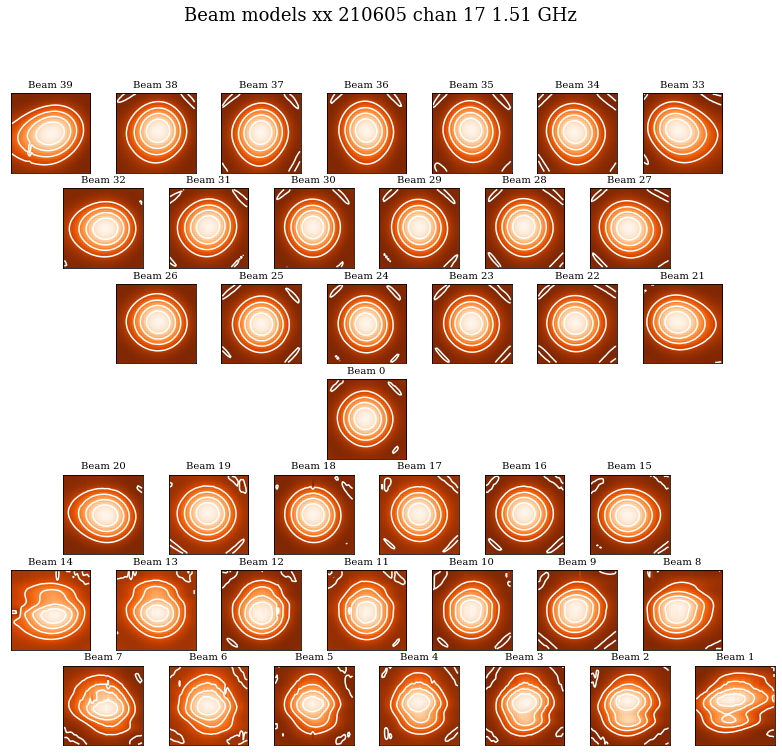

In [7]:
for i in range(1,18):
    make_beam_plots_xx('211103', i)

In [8]:
def make_beam_plots_yy(date, chan):
    nrows = 7
    ncols = 7*2+1
    beams = 40
    #freq = 1234867750.0 + 18310500.0 * chan # old files
    freq = 1299345884.0 + 12207000.0 * chan

    df_1 = pd.read_csv('/tank/apertif/driftscans/spline/{0}/beam_models_{0}_chann_{1}_pol_yy.csv'.format(date, chan))    
    size = int(np.sqrt(len(df_1['B{:02d}_{}'.format(1, int(freq))])))

    fig = plt.figure(figsize=(14,12))
    gs = gridspec.GridSpec(nrows=nrows, ncols=ncols, figure=fig) #, width_ratios=[1]*ncols, height_ratios=[1]*nrows, wspace=0.4, hspace=0.7)

    # Arrange the plots approx according to beam spacing (only beam 0 really fails)
    ax = [None] * beams
    for b in range(beams-1,-1,-1):
        if (b <= 39) & (b >= 33):
            ax[b] = fig.add_subplot(gs[0,2*(39-b):2*(39-b)+2])
        if (b <= 32) & (b >= 27):
            ax[b] = fig.add_subplot(gs[1,2*(32-b)+1:2*(32-b)+2+1])
        if (b <= 26) & (b >= 21):
            ax[b] = fig.add_subplot(gs[2,2*(26-b)+2:2*(26-b)+2+2])
        if (b == 0):
            ax[b] = fig.add_subplot(gs[3,2*3:2*3+2])
        if (b <= 20) & (b >= 15):
            ax[b] = fig.add_subplot(gs[4,2*(20-b)+1:2*(20-b)+2+1])
        if (b <= 14) & (b >= 8):
            ax[b] = fig.add_subplot(gs[5,2*(14-b):2*(14-b)+2])
        if (b <= 7) & (b >= 1):
            ax[b] = fig.add_subplot(gs[6,2*(7-b)+1:2*(7-b)+2+1])
        ax[b].set_xticks([])
        ax[b].set_yticks([])

    for b in range(beams):
        cb_1 = np.array(df_1['B{:02d}_{}'.format(b, int(freq))]).reshape(size, size)
        ax[b].imshow(cb_1, cmap='Blues')
        ax[b].contour(cb_1, levels=[0,0.2,0.4,0.6,0.8], colors='w')
        ax[b].set_title("Beam {}".format(b), size=10)

    fig.suptitle("Beam models yy {} chan {} {} GHz".format(date, chan, round(freq/1e9,2)), size=18)    
    plt.savefig('/tank/apertif/driftscans/spline/{0}/{0}_beams_yy_chan_{1}.png'.format(date, chan), dpi=100, bbox_inches="tight")


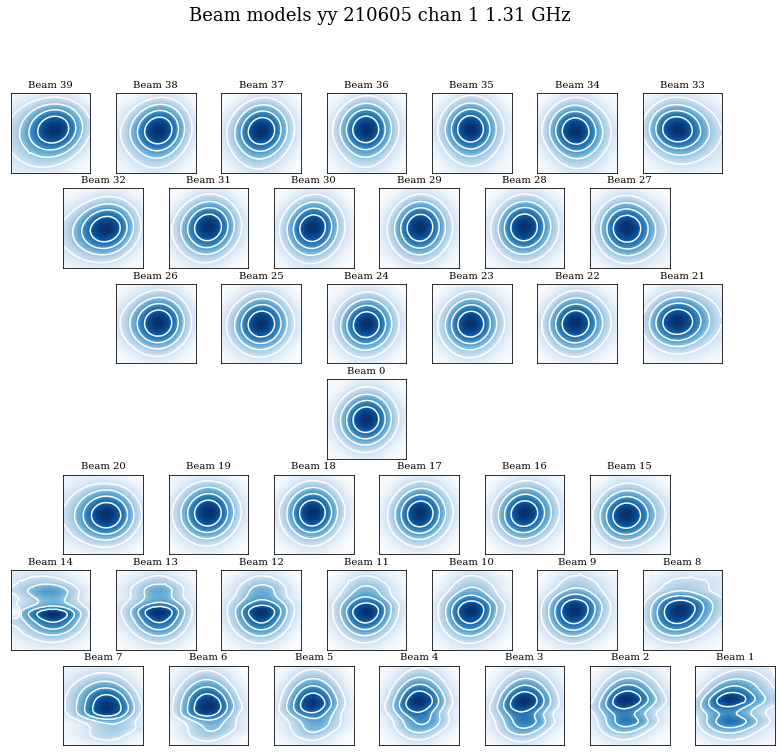

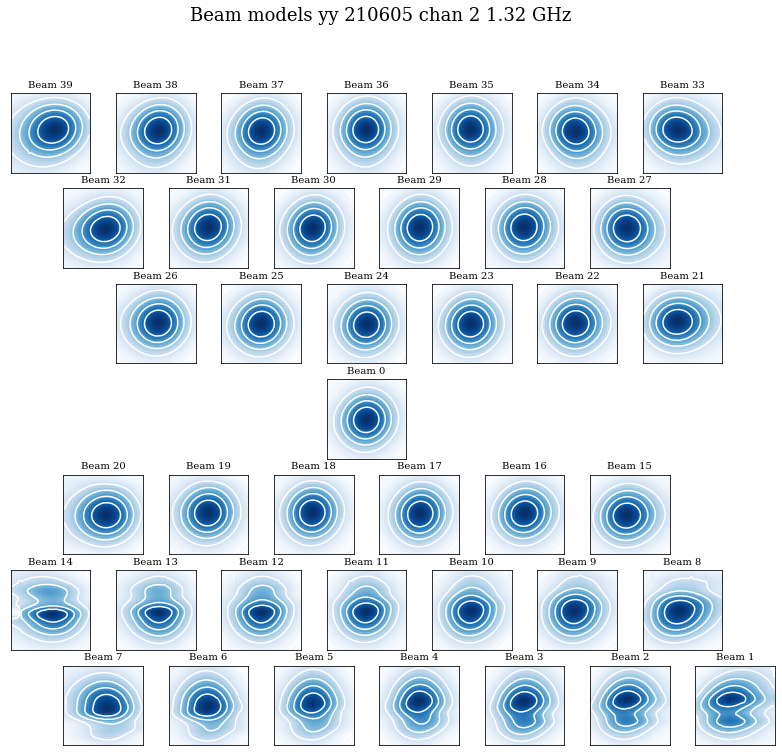

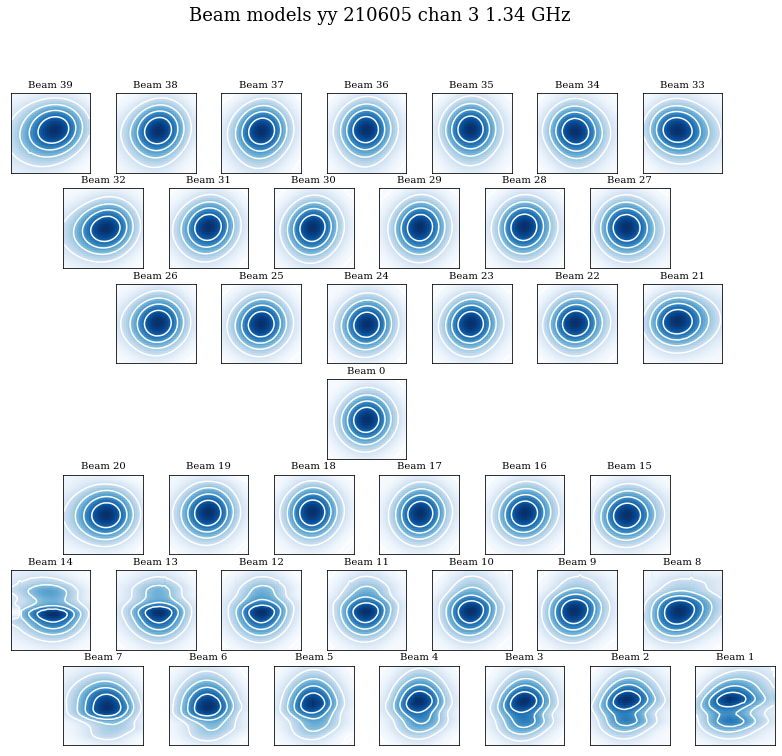

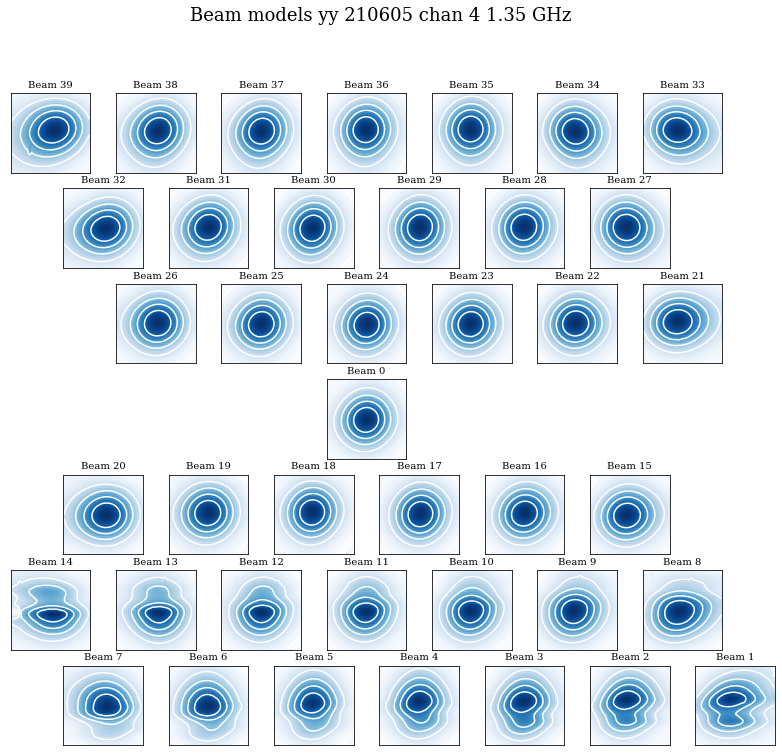

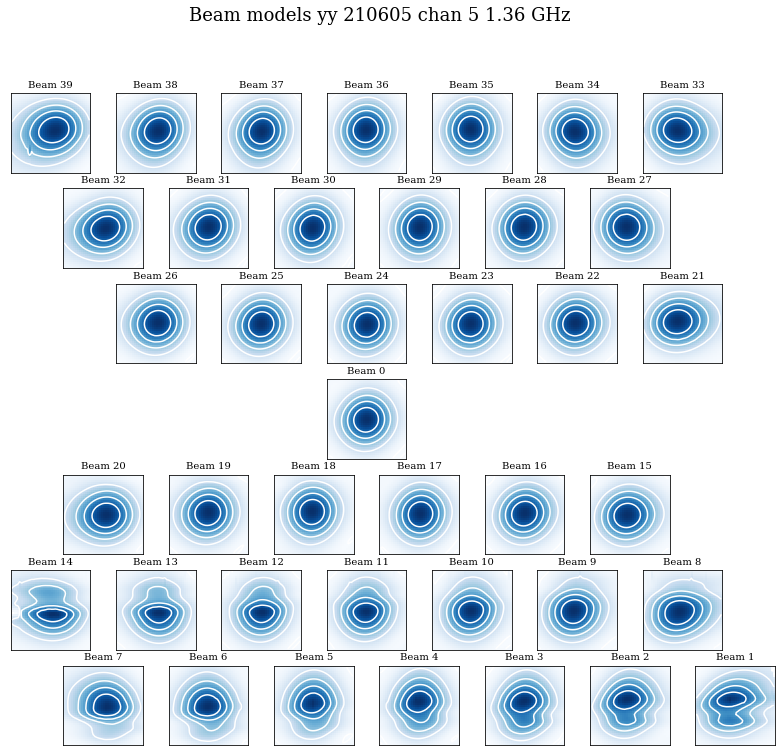

...

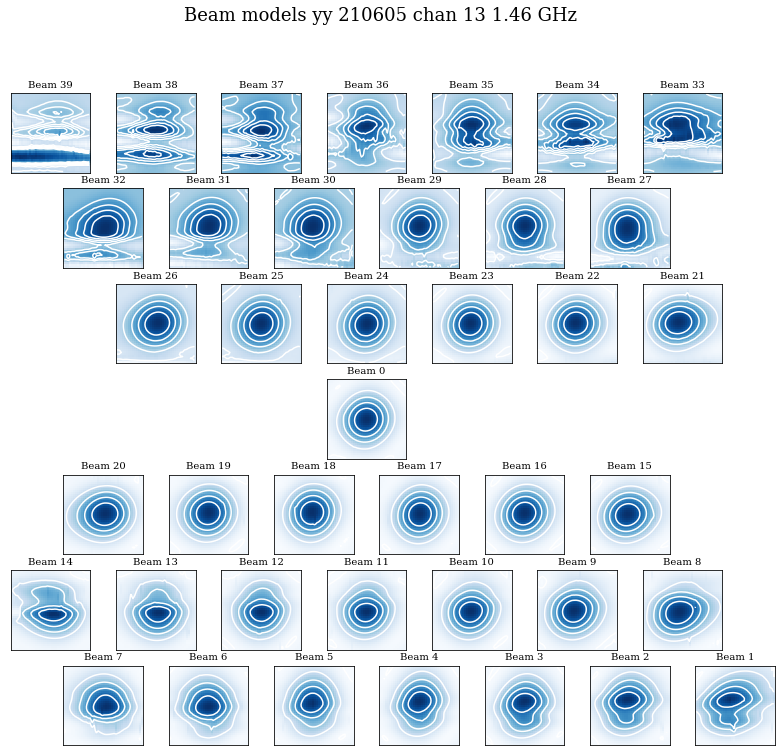

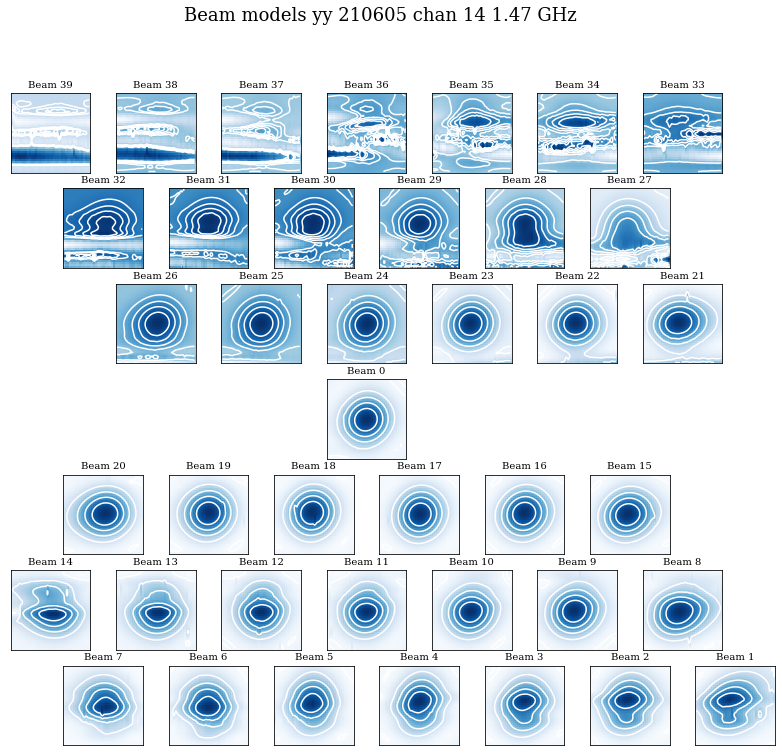

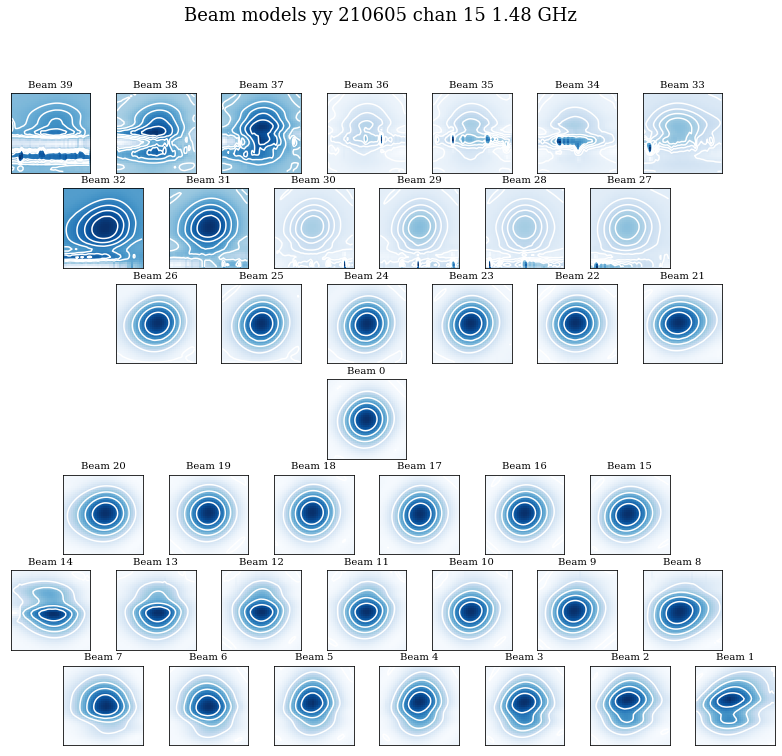

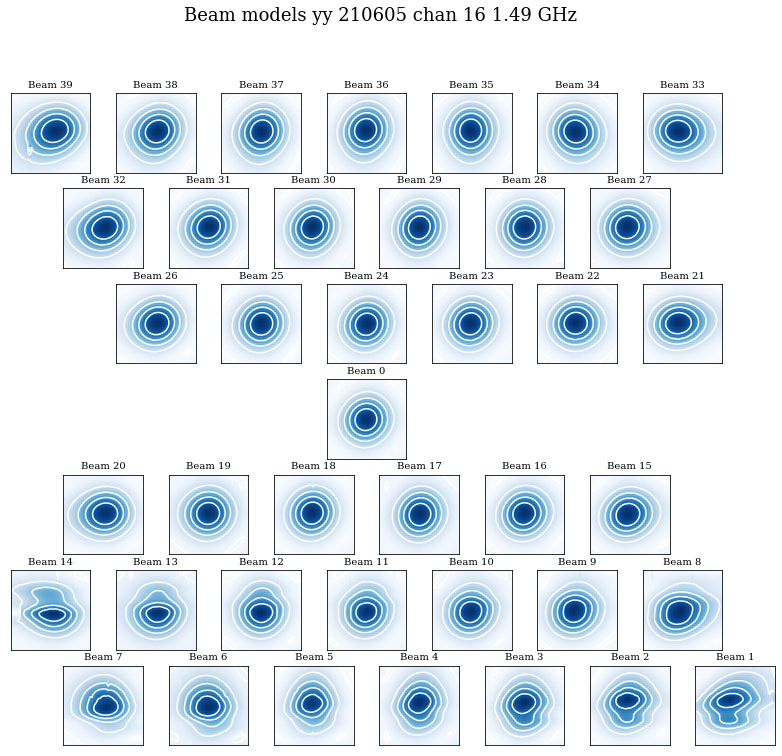

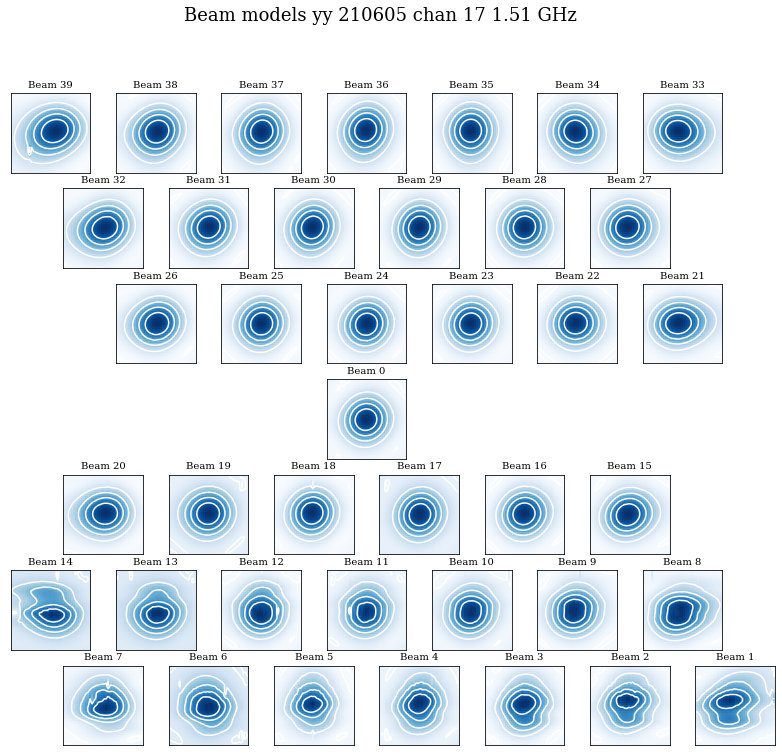

In [9]:
for i in range(1,18):
    make_beam_plots_yy('211103', i)

# Make individual beam plots

/home/apercal/pipeline/lib/python3.7/site-packages/ipykernel_launcher.py:25: UserWarning: The following kwargs were not used by contour: 'linestyle'


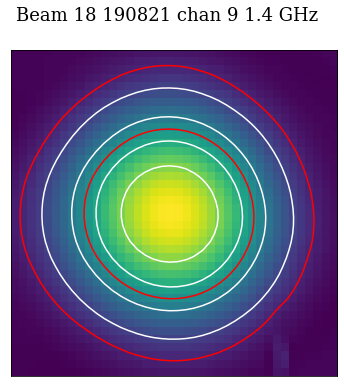

In [7]:
def make_beam_plots(date, chan, beam):
    nrows = 7
    ncols = 7*2+1
    beams = 40
    freq = 1234867750.0 + 18310500.0 * chan  #old files
    #freq = 1299345884.0 + 12207000.0 * chan
    

    df_1 = pd.read_csv('/tank/apertif/driftscans/spline/{0}/beam_models_{0}_chann_{1}_pol_I.csv'.format(date, chan))
    
    size = int(np.sqrt(len(df_1['B{:02d}_{}'.format(1, int(freq))])))

    fig = plt.figure(figsize=(7,6))
    gs = gridspec.GridSpec(nrows=nrows, ncols=ncols, figure=fig) #, width_ratios=[1]*ncols, height_ratios=[1]*nrows, wspace=0.4, hspace=0.7)

    # Arrange the plots approx according to beam spacing (only beam 0 really fails)
    ax = fig.add_subplot(111)
    ax.set_xticks([])
    ax.set_yticks([])

    cb = np.array(df_1['B{:02d}_{}'.format(beam, int(freq))]).reshape(size, size)
    cb = np.flipud(cb)
    ax.imshow(cb)
    ax.contour(cb, levels=[0,0.2,0.4,0.6,0.8], colors='w')
    ax.contour(cb, levels=[0.1, 0.5], colors='r', linestyle=':')
    #ax.contour(cb, levels=[0.5], colors='r', linestyle=':')
    #ax.set_title("Beam {}".format(beam), size=10)

    fig.suptitle("Beam {} {} chan {} {} GHz".format(beam, date, chan, round(freq/1e9,2)), size=18)    
    plt.savefig('/tank/apertif/driftscans/spline/{}/{}_beam_{:02d}_chan_{}.png'.format(date, date, beam, chan), dpi=100, bbox_inches="tight")

make_beam_plots('190821', 7, 18)